# 📒 Notebook 01 — Data Download & Exploratory Data Analysis (EDA)
## TomatoCare Project

**What we're doing in this notebook:**
1. Download all 4 datasets from Kaggle/online sources
2. Explore the data — how many images? what classes? what do they look like?
3. Identify problems — class imbalance, duplicates, bad images
4. Understand the differences between lab vs real-world images

**Why this matters:**
Before building any model, we MUST understand our data. A model is only as good as the data it learns from. If we skip this step, we'll waste hours training on messy data and get bad results.

---

## Step 0: Install Required Packages
Run this cell once to install everything we need.

In [1]:
# Run this ONCE to install packages
# After installing, you can comment this cell out

!pip install kaggle opencv-python matplotlib seaborn numpy pandas tqdm Pillow scikit-learn albumentations

Defaulting to user installation because normal site-packages is not writeable



[notice] A new release of pip is available: 26.0 -> 26.0.1
[notice] To update, run: python.exe -m pip install --upgrade pip


## Step 1: Setup & Imports

First, we import all the libraries we need. Think of libraries as toolboxes:
- `os`, `shutil`, `glob` → file/folder management
- `numpy` → math operations on arrays
- `pandas` → data tables (like Excel but in Python)
- `matplotlib`, `seaborn` → making charts and plots
- `cv2` (OpenCV) → reading and processing images
- `PIL` → another image library (simpler than OpenCV)

In [2]:
import os
import shutil
import glob
from pathlib import Path
from collections import Counter

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from PIL import Image
import cv2
from tqdm import tqdm
import warnings
warnings.filterwarnings('ignore')

# Make plots look nice
plt.style.use('seaborn-v0_8-whitegrid')
plt.rcParams['figure.figsize'] = (12, 6)
plt.rcParams['font.size'] = 12

print('All imports successful! ✅')

All imports successful! ✅


## Step 2: Define Project Paths

We set up all our folder paths here. The `Path` object makes it easy to work with file paths across Windows/Mac/Linux.

⚠️ **IMPORTANT:** Change `PROJECT_ROOT` below to match where you saved the TomatoCare folder on your PC.

In [4]:
# ============================================================
# ⚠️ CHANGE THIS to your actual TomatoCare folder location
# ============================================================
# Examples:
#   Windows: PROJECT_ROOT = Path(r'C:\Users\Albaraa\Projects\TomatoCare')
#   Mac:     PROJECT_ROOT = Path('/Users/albaraa/Projects/TomatoCare')
#   Linux:   PROJECT_ROOT = Path('/home/albaraa/Projects/TomatoCare')

PROJECT_ROOT = Path(r'C:\Users\POTATO\Desktop\Code\tomato-care')  # <-- CHANGE THIS to your path

# ============================================================
# These are auto-generated from PROJECT_ROOT (don't change)
# ============================================================
DATA_RAW      = PROJECT_ROOT / 'data' / 'raw'
DATA_PROCESSED = PROJECT_ROOT / 'data' / 'processed'
DATA_AUGMENTED = PROJECT_ROOT / 'data' / 'augmented'
NOTEBOOKS     = PROJECT_ROOT / 'notebooks'
RESULTS_PLOTS = PROJECT_ROOT / 'results' / 'plots'

# Create all folders if they don't exist
for folder in [DATA_RAW, DATA_PROCESSED, DATA_AUGMENTED, RESULTS_PLOTS,
               DATA_RAW / 'PlantVillage', DATA_RAW / 'PlantDoc',
               DATA_RAW / 'TomatoVillage', DATA_RAW / 'Mendeley']:
    folder.mkdir(parents=True, exist_ok=True)

print(f'Project root: {PROJECT_ROOT.resolve()}')
print(f'Raw data:     {DATA_RAW.resolve()}')
print('Folders created! ✅')

Project root: C:\Users\POTATO\Desktop\Code\tomato-care
Raw data:     C:\Users\POTATO\Desktop\Code\tomato-care\data\raw
Folders created! ✅


## Step 3: Download Datasets from Kaggle

We'll use the Kaggle API to download datasets. Here's what you need to do **once**:

### 🔑 Kaggle API Setup (one-time)
1. Go to [kaggle.com](https://www.kaggle.com) → Sign in
2. Click your profile picture (top right) → **Settings**
3. Scroll to **API** section → Click **"Create New Token"**
4. This downloads a file called `kaggle.json`
5. Place it here:
   - **Windows:** `C:\Users\YourName\.kaggle\kaggle.json`
   - **Mac/Linux:** `~/.kaggle/kaggle.json`

That's it! Now the code below can download datasets automatically.

In [5]:
# ============================================================
# DATASET 1: PlantVillage (Main dataset — lab images)
# ============================================================
# Source: https://www.kaggle.com/datasets/abdallahalidev/plantvillage-dataset
# Contains: ~54,000 images of 38 plant disease classes
# We only need the TOMATO classes (10 folders)

print('📥 Downloading PlantVillage dataset...')
print('This is the largest dataset (~2GB). It may take a few minutes.\n')

!kaggle datasets download -d abdallahalidev/plantvillage-dataset \
    -p "{DATA_RAW / 'PlantVillage'}" --unzip

print('\n✅ PlantVillage downloaded!')

📥 Downloading PlantVillage dataset...
This is the largest dataset (~2GB). It may take a few minutes.

Dataset URL: https://www.kaggle.com/datasets/abdallahalidev/plantvillage-dataset
License(s): CC-BY-NC-SA-4.0


✅ PlantVillage downloaded!



  0%|          | 0.00/2.04G [00:00<?, ?B/s]
  0%|          | 1.00M/2.04G [00:01<46:30, 784kB/s]
  0%|          | 2.00M/2.04G [00:01<23:06, 1.58MB/s]
  0%|          | 3.00M/2.04G [00:01<14:25, 2.53MB/s]
  0%|          | 4.00M/2.04G [00:01<10:13, 3.56MB/s]
  0%|          | 7.00M/2.04G [00:01<04:42, 7.71MB/s]
  0%|          | 9.00M/2.04G [00:02<03:41, 9.83MB/s]
  1%|          | 12.0M/2.04G [00:02<02:54, 12.5MB/s]
  1%|          | 14.0M/2.04G [00:02<02:50, 12.8MB/s]
  1%|          | 16.0M/2.04G [00:02<03:04, 11.8MB/s]
  1%|          | 18.0M/2.04G [00:02<03:00, 12.0MB/s]
  1%|          | 21.0M/2.04G [00:02<02:25, 14.9MB/s]
  1%|          | 23.0M/2.04G [00:02<02:28, 14.6MB/s]
  1%|          | 25.0M/2.04G [00:03<02:31, 14.3MB/s]
  1%|▏         | 28.0M/2.04G [00:03<02:20, 15.4MB/s]
  1%|▏         | 30.0M/2.04G [00:03<03:13, 11.2MB/s]
  2%|▏         | 32.0M/2.04G [00:03<03:04, 11.7MB/s]
  2%|▏         | 36.0M/2.04G [00:04<02:27, 14.6MB/s]
  2%|▏         | 39.0M/2.04G [00:04<02:18, 15.5MB/s]
  

In [6]:
# ============================================================
# DATASET 2: PlantDoc (Real-world images)
# ============================================================
# Source: https://www.kaggle.com/datasets/nirmalsankalana/plantdoc-dataset
# Alt 1:  https://www.kaggle.com/datasets/abdulhasibuddin/plant-doc-dataset
# Alt 2:  https://github.com/pratikkayal/PlantDoc-Dataset (original GitHub)
# Contains: ~2,598 real-world plant disease images (13 species)

print('📥 Downloading PlantDoc dataset...')

# Try the main source first
!kaggle datasets download -d nirmalsankalana/plantdoc-dataset \
    -p "{DATA_RAW / 'PlantDoc'}" --unzip

# If the above fails, uncomment and try this alternative:
# !kaggle datasets download -d abdulhasibuddin/plant-doc-dataset \
#     -p "{DATA_RAW / 'PlantDoc'}" --unzip

print('\n✅ PlantDoc downloaded!')

📥 Downloading PlantDoc dataset...
Dataset URL: https://www.kaggle.com/datasets/nirmalsankalana/plantdoc-dataset
License(s): CC0-1.0


✅ PlantDoc downloaded!



  0%|          | 0.00/896M [00:00<?, ?B/s]
  0%|          | 1.00M/896M [00:01<20:35, 759kB/s]
  0%|          | 2.00M/896M [00:01<10:10, 1.54MB/s]
  0%|          | 3.00M/896M [00:01<06:18, 2.47MB/s]
  1%|          | 5.00M/896M [00:01<03:19, 4.68MB/s]
  1%|          | 8.00M/896M [00:01<01:52, 8.24MB/s]
  1%|          | 10.0M/896M [00:02<01:30, 10.3MB/s]
  1%|▏         | 12.0M/896M [00:02<01:15, 12.3MB/s]
  2%|▏         | 14.0M/896M [00:02<01:05, 14.1MB/s]
  2%|▏         | 16.0M/896M [00:02<01:00, 15.4MB/s]
  2%|▏         | 19.0M/896M [00:02<00:52, 17.6MB/s]
  2%|▏         | 21.0M/896M [00:02<00:51, 17.8MB/s]
  3%|▎         | 24.0M/896M [00:02<00:49, 18.5MB/s]
  3%|▎         | 26.0M/896M [00:02<00:49, 18.4MB/s]
  3%|▎         | 28.0M/896M [00:03<00:54, 16.7MB/s]
  3%|▎         | 30.0M/896M [00:03<00:53, 17.0MB/s]
  4%|▎         | 32.0M/896M [00:03<00:50, 17.8MB/s]
  4%|▍         | 34.0M/896M [00:03<00:55, 16.2MB/s]
  4%|▍         | 36.0M/896M [00:03<00:58, 15.3MB/s]
  4%|▍         | 40.0

In [7]:
# ============================================================
# DATASET 3: Tomato-Village (Field images)
# ============================================================
# Source: https://www.kaggle.com/datasets/mamtag/tomato-village
# Contains: Real field images of tomato diseases

print('📥 Downloading Tomato-Village dataset...')

!kaggle datasets download -d mamtag/tomato-village \
    -p "{DATA_RAW / 'TomatoVillage'}" --unzip

print('\n✅ Tomato-Village downloaded!')

📥 Downloading Tomato-Village dataset...
Dataset URL: https://www.kaggle.com/datasets/mamtag/tomato-village
License(s): unknown


✅ Tomato-Village downloaded!



  0%|          | 0.00/1.50G [00:00<?, ?B/s]
  0%|          | 1.00M/1.50G [00:01<34:05, 787kB/s]
  0%|          | 2.00M/1.50G [00:01<16:56, 1.58MB/s]
  0%|          | 3.00M/1.50G [00:01<10:33, 2.54MB/s]
  0%|          | 5.00M/1.50G [00:01<05:36, 4.77MB/s]
  0%|          | 7.00M/1.50G [00:01<04:00, 6.66MB/s]
  1%|          | 9.00M/1.50G [00:02<03:14, 8.25MB/s]
  1%|          | 11.0M/1.50G [00:02<02:47, 9.56MB/s]
  1%|          | 13.0M/1.50G [00:02<02:30, 10.6MB/s]
  1%|          | 15.0M/1.50G [00:02<02:19, 11.4MB/s]
  1%|          | 17.0M/1.50G [00:02<02:11, 12.1MB/s]
  1%|          | 19.0M/1.50G [00:02<02:07, 12.5MB/s]
  1%|▏         | 21.0M/1.50G [00:03<02:03, 12.9MB/s]
  1%|▏         | 23.0M/1.50G [00:03<02:01, 13.1MB/s]
  2%|▏         | 25.0M/1.50G [00:03<01:59, 13.2MB/s]
  2%|▏         | 27.0M/1.50G [00:03<01:59, 13.3MB/s]
  2%|▏         | 29.0M/1.50G [00:03<01:58, 13.4MB/s]
  2%|▏         | 31.0M/1.50G [00:03<01:57, 13.5MB/s]
  2%|▏         | 33.0M/1.50G [00:03<01:56, 13.5MB/s]
  

In [ ]:
# ============================================================
# DATASET 4: Kaggle Tomato Leaf Dataset (another source)
# ============================================================
# Source: https://www.kaggle.com/datasets/kaustubhb999/tomatoleaf
# Contains: Tomato leaf images organized by disease

print('📥 Downloading Tomato Leaf dataset...')

!kaggle datasets download -d kaustubhb999/tomatoleaf \
    -p "{DATA_RAW / 'Mendeley'}" --unzip

print('\n✅ Tomato Leaf dataset downloaded!')

### 🔄 Alternative: Manual Download

If the Kaggle API doesn't work, you can download manually:

1. **PlantVillage:** https://www.kaggle.com/datasets/abdallahalidev/plantvillage-dataset → Download → Extract to `data/raw/PlantVillage/`
2. **PlantDoc:** https://www.kaggle.com/datasets/nirmalsankalana/plantdoc-dataset → Download → Extract to `data/raw/PlantDoc/`
   - Alt link: https://www.kaggle.com/datasets/abdulhasibuddin/plant-doc-dataset
   - Alt link: https://github.com/pratikkayal/PlantDoc-Dataset (click Code → Download ZIP)
3. **Tomato-Village:** https://www.kaggle.com/datasets/mamtag/tomato-village → Download → Extract to `data/raw/TomatoVillage/`
4. **Tomato Leaf:** https://www.kaggle.com/datasets/kaustubhb999/tomatoleaf → Download → Extract to `data/raw/Mendeley/`

After downloading, continue to the next cell.

---
## Step 4: Explore What We Downloaded

Let's see what's inside each dataset folder. This is the first thing you should ALWAYS do after getting data — look at it before touching it.

In [9]:
def explore_folder(path, name):
    """
    Scans a dataset folder and reports what's inside.
    
    What this does:
    - Walks through all subfolders
    - Counts image files (jpg, jpeg, png, bmp)
    - Reports the folder structure
    """
    print(f'\n{"=" * 60}')
    print(f'📁 Dataset: {name}')
    print(f'   Path: {path}')
    print(f'{"=" * 60}')
    
    if not path.exists():
        print('   ❌ Folder not found! Download this dataset first.')
        return {}
    
    # Supported image extensions
    img_extensions = {'.jpg', '.jpeg', '.png', '.bmp', '.JPG', '.JPEG', '.PNG'}
    
    class_counts = {}
    total = 0
    
    # Walk through all subdirectories
    for root, dirs, files in os.walk(path):
        # Count images in this folder
        images = [f for f in files if Path(f).suffix in img_extensions]
        if images:
            # Get the folder name (this is usually the class name)
            folder_name = os.path.basename(root)
            class_counts[folder_name] = len(images)
            total += len(images)
    
    if class_counts:
        print(f'\n   Total images: {total:,}')
        print(f'   Total classes: {len(class_counts)}')
        print(f'\n   Class breakdown:')
        for cls, count in sorted(class_counts.items()):
            bar = '█' * (count // 100)  # Visual bar
            print(f'   {cls:45s} → {count:5,} images  {bar}')
    else:
        print('   ⚠️ No images found. Check the folder structure.')
    
    return class_counts


# Explore all 4 datasets
pv_counts  = explore_folder(DATA_RAW / 'PlantVillage', 'PlantVillage (Lab Images)')
pd_counts  = explore_folder(DATA_RAW / 'PlantDoc', 'PlantDoc (Real-World Images)')
tv_counts  = explore_folder(DATA_RAW / 'TomatoVillage', 'Tomato-Village (Field Images)')
mn_counts  = explore_folder(DATA_RAW / 'Mendeley', 'Mendeley/TomatoLeaf (Mixed)')


📁 Dataset: PlantVillage (Lab Images)
   Path: C:\Users\POTATO\Desktop\Code\tomato-care\data\raw\PlantVillage

   Total images: 18,160
   Total classes: 10

   Class breakdown:
   Tomato___Bacterial_spot                       → 2,127 images  █████████████████████
   Tomato___Early_blight                         → 1,000 images  ██████████
   Tomato___Late_blight                          → 1,909 images  ███████████████████
   Tomato___Leaf_Mold                            →   952 images  █████████
   Tomato___Septoria_leaf_spot                   → 1,771 images  █████████████████
   Tomato___Spider_mites Two-spotted_spider_mite → 1,676 images  ████████████████
   Tomato___Target_Spot                          → 1,404 images  ██████████████
   Tomato___Tomato_Yellow_Leaf_Curl_Virus        → 5,357 images  █████████████████████████████████████████████████████
   Tomato___Tomato_mosaic_virus                  →   373 images  ███
   Tomato___healthy                              → 1,591 images  ██

## Step 5: Filter Only Tomato Classes

Some datasets (like PlantVillage) contain ALL plant species, not just tomato.
We need to extract only the **10 tomato classes** we care about.

The tomato folders usually have names starting with `Tomato` or `tomato`.

In [10]:
# ============================================================
# Our 10 target classes with standardized names
# ============================================================
# We need to map different naming conventions from each dataset
# to ONE consistent set of folder names.

TARGET_CLASSES = [
    'Bacterial_Spot',
    'Early_Blight',
    'Late_Blight',
    'Leaf_Mold',
    'Septoria_Leaf_Spot',
    'Spider_Mites',
    'Target_Spot',
    'Yellow_Leaf_Curl_Virus',
    'Mosaic_Virus',
    'Healthy'
]

print(f'Target classes ({len(TARGET_CLASSES)}):')
for i, cls in enumerate(TARGET_CLASSES, 1):
    print(f'  {i:2d}. {cls}')

Target classes (10):
   1. Bacterial_Spot
   2. Early_Blight
   3. Late_Blight
   4. Leaf_Mold
   5. Septoria_Leaf_Spot
   6. Spider_Mites
   7. Target_Spot
   8. Yellow_Leaf_Curl_Virus
   9. Mosaic_Virus
  10. Healthy


In [12]:
def find_tomato_folders(dataset_path):
    """
    Finds all folders that contain tomato-related images.
    
    Different datasets name their folders differently:
    - PlantVillage: 'Tomato___Bacterial_spot'
    - PlantDoc:     'Tomato leaf bacterial spot'
    - Others:       'Bacterial_Spot' or 'bacterial_spot'
    
    This function finds them all.
    """
    tomato_folders = []
    img_extensions = {'.jpg', '.jpeg', '.png', '.bmp', '.JPG', '.JPEG', '.PNG'}
    
    for root, dirs, files in os.walk(dataset_path):
        # Check if this folder has images
        images = [f for f in files if Path(f).suffix in img_extensions]
        if images:
            folder_name = os.path.basename(root).lower()
            # Check if it's tomato-related
            if 'tomato' in folder_name or any(
                keyword in folder_name for keyword in [
                    'bacterial_spot', 'early_blight', 'late_blight',
                    'leaf_mold', 'septoria', 'spider', 'target_spot',
                    'yellow_leaf', 'mosaic', 'healthy',
                    'bacterial spot', 'early blight', 'late blight',
                    'leaf mold', 'spider mite'
                ]
            ):
                tomato_folders.append({
                    'path': root,
                    'name': os.path.basename(root),
                    'count': len(images)
                })
    
    return tomato_folders


# Find tomato folders in each dataset
print('🔍 Searching for tomato-related folders in each dataset...\n')

for dataset_name, dataset_path in [
    ('PlantVillage', DATA_RAW / 'PlantVillage'),
    ('PlantDoc', DATA_RAW / 'PlantDoc'),
    ('TomatoVillage', DATA_RAW / 'TomatoVillage'),
    ('Mendeley', DATA_RAW / 'Mendeley')
]:
    folders = find_tomato_folders(dataset_path)
    print(f'📁 {dataset_name}: Found {len(folders)} tomato folders')
    for f in folders:
        print(f'    → {f["name"]} ({f["count"]} images)')
    print()

🔍 Searching for tomato-related folders in each dataset...

📁 PlantVillage: Found 10 tomato folders
    → Tomato___Bacterial_spot (2127 images)
    → Tomato___Early_blight (1000 images)
    → Tomato___healthy (1591 images)
    → Tomato___Late_blight (1909 images)
    → Tomato___Leaf_Mold (952 images)
    → Tomato___Septoria_leaf_spot (1771 images)
    → Tomato___Spider_mites Two-spotted_spider_mite (1676 images)
    → Tomato___Target_Spot (1404 images)
    → Tomato___Tomato_mosaic_virus (373 images)
    → Tomato___Tomato_Yellow_Leaf_Curl_Virus (5357 images)

📁 PlantDoc: Found 17 tomato folders
    → Tomato_Early_blight_leaf (9 images)
    → Tomato_leaf (8 images)
    → Tomato_leaf_bacterial_spot (9 images)
    → Tomato_leaf_late_blight (10 images)
    → Tomato_leaf_mosaic_virus (10 images)
    → Tomato_leaf_yellow_virus (15 images)
    → Tomato_mold_leaf (6 images)
    → Tomato_Septoria_leaf_spot (12 images)
    → Tomato_Early_blight_leaf (79 images)
    → Tomato_leaf (44 images)
    → 

## Step 6: Visualize Sample Images

Let's actually LOOK at what these diseases look like. This helps us understand:
- What the model needs to learn
- Which diseases look similar (hard pairs)
- How lab images differ from real-world images

💾 Saved to: C:\Users\POTATO\Desktop\Code\tomato-care\results\plots\samples_plantvillage_(lab).png


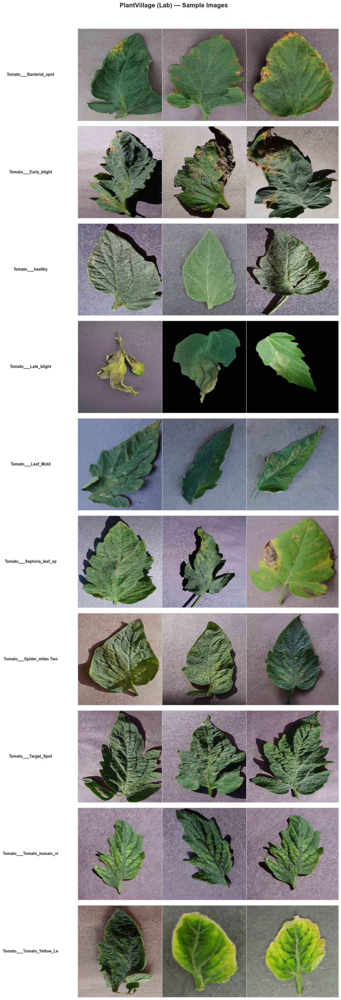

In [13]:
def show_sample_images(dataset_path, dataset_name, samples_per_class=3):
    """
    Shows sample images from each disease class in a grid.
    
    This is important because:
    - We can visually verify the labels are correct
    - We can see the variation within each class
    - We can spot problems (corrupted images, wrong labels)
    """
    tomato_folders = find_tomato_folders(dataset_path)
    
    if not tomato_folders:
        print(f'No tomato folders found in {dataset_name}')
        return
    
    n_classes = len(tomato_folders)
    fig, axes = plt.subplots(n_classes, samples_per_class, 
                             figsize=(4 * samples_per_class, 3.5 * n_classes))
    fig.suptitle(f'{dataset_name} — Sample Images', fontsize=16, fontweight='bold', y=1.01)
    
    if n_classes == 1:
        axes = [axes]
    
    img_extensions = {'.jpg', '.jpeg', '.png', '.bmp', '.JPG', '.JPEG', '.PNG'}
    
    for row, folder_info in enumerate(tomato_folders):
        folder_path = folder_info['path']
        # Get all image files
        all_images = [f for f in os.listdir(folder_path) 
                      if Path(f).suffix in img_extensions]
        
        # Pick random samples
        np.random.seed(42)  # For reproducibility
        chosen = np.random.choice(all_images, 
                                  min(samples_per_class, len(all_images)), 
                                  replace=False)
        
        for col in range(samples_per_class):
            ax = axes[row][col] if n_classes > 1 else axes[col]
            
            if col < len(chosen):
                img_path = os.path.join(folder_path, chosen[col])
                try:
                    img = Image.open(img_path)
                    ax.imshow(img)
                    if col == 0:
                        ax.set_ylabel(folder_info['name'][:25], fontsize=10, 
                                     fontweight='bold', rotation=0, labelpad=120,
                                     va='center')
                except Exception as e:
                    ax.text(0.5, 0.5, f'Error:\n{e}', ha='center', va='center')
            
            ax.set_xticks([])
            ax.set_yticks([])
    
    plt.tight_layout()
    
    # Save the plot
    save_path = RESULTS_PLOTS / f'samples_{dataset_name.lower().replace(" ", "_")}.png'
    plt.savefig(save_path, dpi=150, bbox_inches='tight')
    print(f'💾 Saved to: {save_path}')
    plt.show()


# Show samples from PlantVillage (lab images)
show_sample_images(DATA_RAW / 'PlantVillage', 'PlantVillage (Lab)')

💾 Saved to: C:\Users\POTATO\Desktop\Code\tomato-care\results\plots\samples_plantdoc_(real-world).png


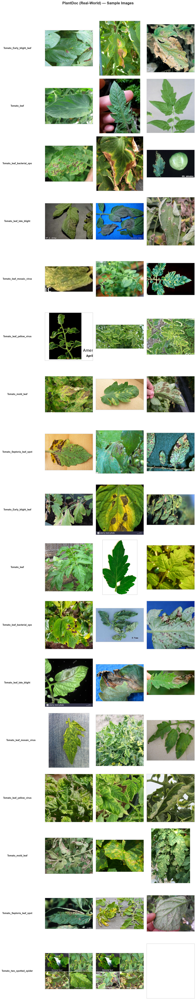

In [14]:
# Show samples from PlantDoc (real-world images)
show_sample_images(DATA_RAW / 'PlantDoc', 'PlantDoc (Real-World)')

💾 Saved to: C:\Users\POTATO\Desktop\Code\tomato-care\results\plots\samples_tomato-village_(field).png


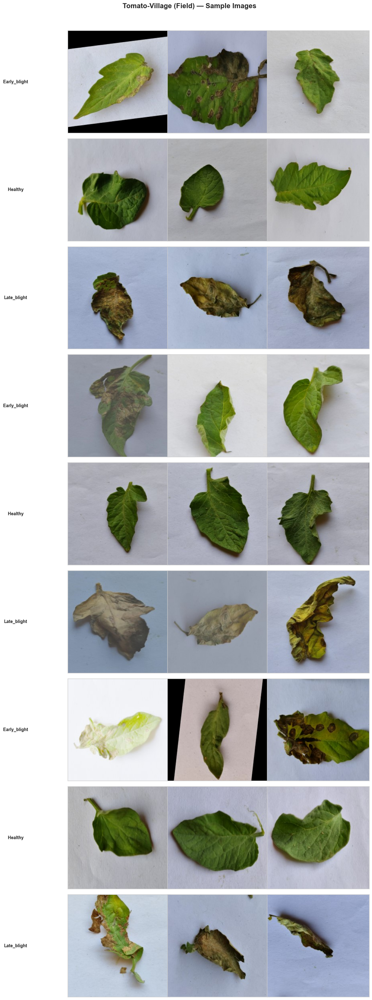

💾 Saved to: C:\Users\POTATO\Desktop\Code\tomato-care\results\plots\samples_mendeley_(mixed).png


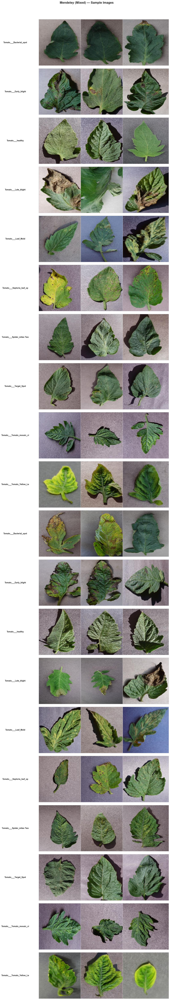

In [15]:
# Show samples from other datasets too
show_sample_images(DATA_RAW / 'TomatoVillage', 'Tomato-Village (Field)')
show_sample_images(DATA_RAW / 'Mendeley', 'Mendeley (Mixed)')

## Step 7: Image Statistics

Let's analyze the technical properties of the images:
- **Resolution** — What sizes are the images? (we need to resize them all to 224×224)
- **Color channels** — Are they all RGB? (some might be grayscale)
- **File sizes** — Any suspiciously small files? (might be corrupted)

In [16]:
def analyze_image_stats(dataset_path, dataset_name, max_images=500):
    """
    Collects technical stats about images in a dataset.
    We sample up to max_images to keep it fast.
    """
    img_extensions = {'.jpg', '.jpeg', '.png', '.bmp', '.JPG', '.JPEG', '.PNG'}
    
    # Collect all image paths
    all_images = []
    for root, dirs, files in os.walk(dataset_path):
        for f in files:
            if Path(f).suffix in img_extensions:
                all_images.append(os.path.join(root, f))
    
    if not all_images:
        print(f'No images found in {dataset_name}')
        return None
    
    # Sample if too many
    np.random.seed(42)
    sample = np.random.choice(all_images, min(max_images, len(all_images)), replace=False)
    
    widths, heights, channels, file_sizes = [], [], [], []
    corrupted = []
    
    for img_path in tqdm(sample, desc=f'Analyzing {dataset_name}'):
        try:
            img = Image.open(img_path)
            w, h = img.size
            widths.append(w)
            heights.append(h)
            # Count channels: RGB=3, Grayscale=1, RGBA=4
            mode_to_channels = {'RGB': 3, 'L': 1, 'RGBA': 4, 'P': 1}
            channels.append(mode_to_channels.get(img.mode, 3))
            file_sizes.append(os.path.getsize(img_path) / 1024)  # KB
        except Exception as e:
            corrupted.append(img_path)
    
    print(f'\n📊 {dataset_name} Image Statistics (sampled {len(sample)} images):')
    print(f'   Resolution range: {min(widths)}×{min(heights)} to {max(widths)}×{max(heights)}')
    print(f'   Most common size: {Counter(zip(widths, heights)).most_common(1)[0]}')
    print(f'   Channels: {Counter(channels).most_common()}')
    print(f'   File size: {np.mean(file_sizes):.1f} KB avg (min: {min(file_sizes):.1f}, max: {max(file_sizes):.1f})')
    print(f'   Corrupted files: {len(corrupted)}')
    if corrupted:
        for c in corrupted[:5]:
            print(f'      ⚠️ {c}')
    
    return {
        'widths': widths, 'heights': heights,
        'channels': channels, 'file_sizes': file_sizes,
        'corrupted': corrupted
    }


# Analyze each dataset
stats = {}
for name, path in [
    ('PlantVillage', DATA_RAW / 'PlantVillage'),
    ('PlantDoc', DATA_RAW / 'PlantDoc'),
    ('TomatoVillage', DATA_RAW / 'TomatoVillage'),
    ('Mendeley', DATA_RAW / 'Mendeley')
]:
    stats[name] = analyze_image_stats(path, name)

Analyzing PlantVillage: 100%|██████████| 500/500 [00:02<00:00, 246.54it/s]



📊 PlantVillage Image Statistics (sampled 500 images):
   Resolution range: 256×256 to 256×256
   Most common size: ((256, 256), 500)
   Channels: [(3, 500)]
   File size: 15.5 KB avg (min: 4.8, max: 27.4)
   Corrupted files: 0


Analyzing PlantDoc: 100%|██████████| 500/500 [00:01<00:00, 265.76it/s]



📊 PlantDoc Image Statistics (sampled 500 images):
   Resolution range: 115×69 to 6000×6000
   Most common size: ((300, 300), 58)
   Channels: [(3, 499), (4, 1)]
   File size: 237.8 KB avg (min: 2.8, max: 5690.4)
   Corrupted files: 0


Analyzing TomatoVillage: 100%|██████████| 500/500 [00:01<00:00, 251.30it/s]



📊 TomatoVillage Image Statistics (sampled 500 images):
   Resolution range: 256×256 to 256×256
   Most common size: ((256, 256), 500)
   Channels: [(3, 500)]
   File size: 127.9 KB avg (min: 4.9, max: 264.6)
   Corrupted files: 0


Analyzing Mendeley: 100%|██████████| 500/500 [00:01<00:00, 259.09it/s]


📊 Mendeley Image Statistics (sampled 500 images):
   Resolution range: 256×256 to 256×256
   Most common size: ((256, 256), 500)
   Channels: [(3, 500)]
   File size: 16.4 KB avg (min: 3.4, max: 27.9)
   Corrupted files: 0


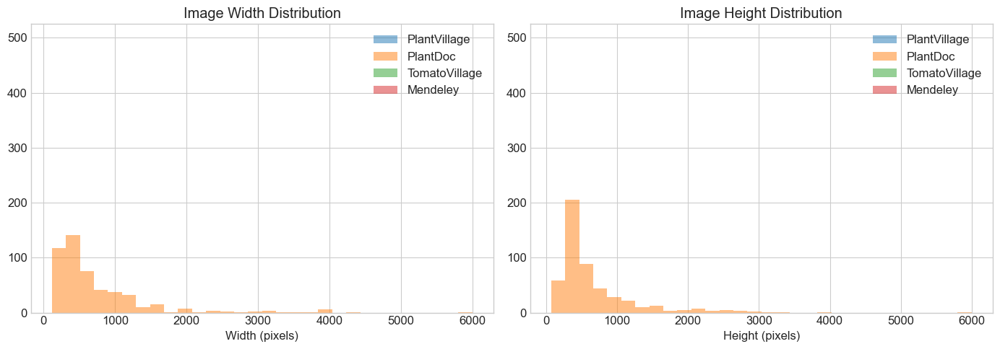

💾 Saved resolution distribution plot


In [17]:
# Visualize resolution distributions
fig, axes = plt.subplots(1, 2, figsize=(14, 5))

for name, s in stats.items():
    if s is not None:
        axes[0].hist(s['widths'], bins=30, alpha=0.5, label=name)
        axes[1].hist(s['heights'], bins=30, alpha=0.5, label=name)

axes[0].set_title('Image Width Distribution')
axes[0].set_xlabel('Width (pixels)')
axes[0].legend()

axes[1].set_title('Image Height Distribution')
axes[1].set_xlabel('Height (pixels)')
axes[1].legend()

plt.tight_layout()
plt.savefig(RESULTS_PLOTS / 'resolution_distribution.png', dpi=150)
plt.show()
print('💾 Saved resolution distribution plot')

## Step 8: Class Distribution Analysis

This is one of the most important EDA steps. We need to know:
- How many images does each disease class have?
- Is it balanced or imbalanced?

**Why it matters:** If one class has 5,000 images and another has 300, the model will get "lazy" and just predict the majority class. We need to fix this later with augmentation.

In [18]:
def count_all_tomato_images(dataset_path):
    """
    Counts tomato images per class in a dataset.
    Returns a dictionary: {class_name: count}
    """
    img_extensions = {'.jpg', '.jpeg', '.png', '.bmp', '.JPG', '.JPEG', '.PNG'}
    counts = {}
    
    tomato_folders = find_tomato_folders(dataset_path)
    for folder in tomato_folders:
        counts[folder['name']] = folder['count']
    
    return counts


# Count images from all datasets
all_counts = {}
for name, path in [
    ('PlantVillage', DATA_RAW / 'PlantVillage'),
    ('PlantDoc', DATA_RAW / 'PlantDoc'),
    ('TomatoVillage', DATA_RAW / 'TomatoVillage'),
    ('Mendeley', DATA_RAW / 'Mendeley')
]:
    all_counts[name] = count_all_tomato_images(path)

# Create a summary table
print('\n📊 Summary: Images per class across all datasets')
print('=' * 80)

for name, counts in all_counts.items():
    if counts:
        total = sum(counts.values())
        print(f'\n{name} ({total:,} total tomato images):')
        for cls, count in sorted(counts.items(), key=lambda x: x[1], reverse=True):
            pct = count / total * 100
            bar = '█' * int(pct)
            print(f'  {cls:45s} {count:5,}  ({pct:5.1f}%) {bar}')


📊 Summary: Images per class across all datasets

PlantVillage (18,160 total tomato images):
  Tomato___Tomato_Yellow_Leaf_Curl_Virus        5,357  ( 29.5%) █████████████████████████████
  Tomato___Bacterial_spot                       2,127  ( 11.7%) ███████████
  Tomato___Late_blight                          1,909  ( 10.5%) ██████████
  Tomato___Septoria_leaf_spot                   1,771  (  9.8%) █████████
  Tomato___Spider_mites Two-spotted_spider_mite 1,676  (  9.2%) █████████
  Tomato___healthy                              1,591  (  8.8%) ████████
  Tomato___Target_Spot                          1,404  (  7.7%) ███████
  Tomato___Early_blight                         1,000  (  5.5%) █████
  Tomato___Leaf_Mold                              952  (  5.2%) █████
  Tomato___Tomato_mosaic_virus                    373  (  2.1%) ██

PlantDoc (824 total tomato images):
  Tomato_leaf_yellow_virus                        223  ( 27.1%) ███████████████████████████
  Tomato_Septoria_leaf_spot      

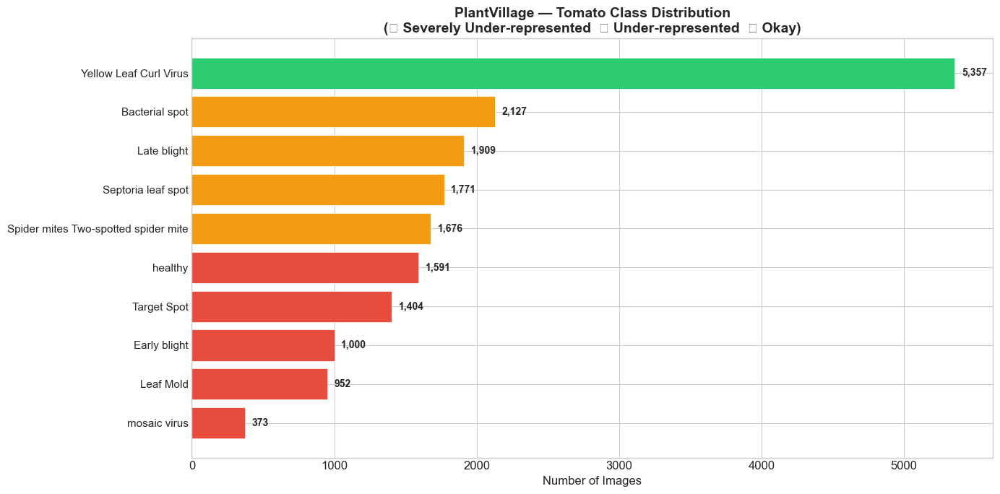


⚠️ Imbalance ratio: 14.4x
   Largest class:  Yellow Leaf Curl Virus (5,357)
   Smallest class: mosaic virus (373)
   This means the largest class has ~14x more images than the smallest!


In [19]:
# Create a beautiful class distribution chart for PlantVillage (our main dataset)
pv_tomato = count_all_tomato_images(DATA_RAW / 'PlantVillage')

if pv_tomato:
    classes = list(pv_tomato.keys())
    counts = list(pv_tomato.values())
    
    # Sort by count
    sorted_pairs = sorted(zip(classes, counts), key=lambda x: x[1], reverse=True)
    classes, counts = zip(*sorted_pairs)
    
    # Shorten class names for display
    short_names = [c.replace('Tomato___', '').replace('Tomato_', '').replace('_', ' ') for c in classes]
    
    # Color: red for most imbalanced, green for okay
    max_count = max(counts)
    colors = ['#e74c3c' if c < max_count * 0.3 else '#f39c12' if c < max_count * 0.5 else '#2ecc71' for c in counts]
    
    fig, ax = plt.subplots(figsize=(14, 7))
    bars = ax.barh(range(len(classes)), counts, color=colors, edgecolor='white', linewidth=0.5)
    
    ax.set_yticks(range(len(classes)))
    ax.set_yticklabels(short_names, fontsize=11)
    ax.set_xlabel('Number of Images', fontsize=12)
    ax.set_title('PlantVillage — Tomato Class Distribution\n(🔴 Severely Under-represented  🟡 Under-represented  🟢 Okay)', 
                 fontsize=14, fontweight='bold')
    
    # Add count labels on bars
    for bar, count in zip(bars, counts):
        ax.text(bar.get_width() + 50, bar.get_y() + bar.get_height()/2,
                f'{count:,}', va='center', fontsize=10, fontweight='bold')
    
    ax.invert_yaxis()  # Largest on top
    plt.tight_layout()
    plt.savefig(RESULTS_PLOTS / 'class_distribution_plantvillage.png', dpi=150, bbox_inches='tight')
    plt.show()
    
    # Print the imbalance ratio
    print(f'\n⚠️ Imbalance ratio: {max(counts) / max(1, min(counts)):.1f}x')
    print(f'   Largest class:  {short_names[0]} ({counts[0]:,})')
    print(f'   Smallest class: {short_names[-1]} ({counts[-1]:,})')
    print(f'   This means the largest class has ~{max(counts)//max(1,min(counts))}x more images than the smallest!')
else:
    print('⚠️ No PlantVillage tomato data found. Check the download.')

## Step 9: Compare Lab vs Real-World Images

This is a critical comparison. Let's see the same disease class from PlantVillage (lab) vs PlantDoc (real-world) side by side.

**What to look for:**
- Lab images: clean background, single leaf, consistent lighting
- Real-world images: complex background, multiple leaves, shadows, occlusion

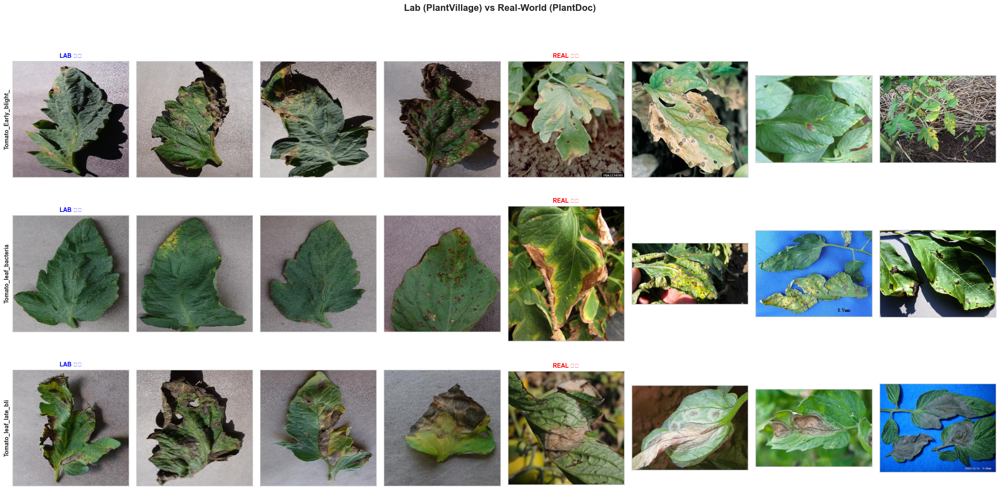

💾 Saved comparison plot


In [20]:
def compare_lab_vs_real(lab_path, real_path, n_samples=4):
    """
    Side-by-side comparison of lab vs real-world images
    for the same disease classes.
    """
    lab_folders = find_tomato_folders(lab_path)
    real_folders = find_tomato_folders(real_path)
    
    if not lab_folders or not real_folders:
        print('Need both lab and real-world datasets for comparison')
        return
    
    img_extensions = {'.jpg', '.jpeg', '.png', '.bmp', '.JPG', '.JPEG', '.PNG'}
    
    # Show up to 3 matching classes
    shown = 0
    fig, axes = plt.subplots(min(3, len(real_folders)), n_samples * 2, 
                             figsize=(3 * n_samples * 2, 4 * min(3, len(real_folders))))
    fig.suptitle('Lab (PlantVillage) vs Real-World (PlantDoc)', 
                 fontsize=16, fontweight='bold', y=1.02)
    
    if min(3, len(real_folders)) == 1:
        axes = [axes]
    
    np.random.seed(42)
    
    for real_f in real_folders:
        if shown >= 3:
            break
        
        # Find matching lab folder
        real_name = real_f['name'].lower()
        matching_lab = None
        for lab_f in lab_folders:
            lab_name = lab_f['name'].lower()
            # Check for keyword overlap
            if any(kw in real_name and kw in lab_name 
                   for kw in ['blight', 'spot', 'mold', 'healthy', 'mosaic', 'curl', 'spider', 'septoria']):
                matching_lab = lab_f
                break
        
        if matching_lab is None:
            continue
        
        row = axes[shown]
        
        # Show lab images
        lab_images = [f for f in os.listdir(matching_lab['path']) if Path(f).suffix in img_extensions]
        chosen_lab = np.random.choice(lab_images, min(n_samples, len(lab_images)), replace=False)
        
        for col, img_name in enumerate(chosen_lab[:n_samples]):
            try:
                img = Image.open(os.path.join(matching_lab['path'], img_name))
                row[col].imshow(img)
                if col == 0:
                    row[col].set_title('LAB ⬇️', fontsize=10, fontweight='bold', color='blue')
            except:
                pass
            row[col].set_xticks([])
            row[col].set_yticks([])
        
        # Show real images
        real_images = [f for f in os.listdir(real_f['path']) if Path(f).suffix in img_extensions]
        chosen_real = np.random.choice(real_images, min(n_samples, len(real_images)), replace=False)
        
        for col, img_name in enumerate(chosen_real[:n_samples]):
            try:
                img = Image.open(os.path.join(real_f['path'], img_name))
                row[col + n_samples].imshow(img)
                if col == 0:
                    row[col + n_samples].set_title('REAL ⬇️', fontsize=10, fontweight='bold', color='red')
            except:
                pass
            row[col + n_samples].set_xticks([])
            row[col + n_samples].set_yticks([])
        
        # Row label
        row[0].set_ylabel(real_f['name'][:20], fontsize=10, fontweight='bold')
        shown += 1
    
    plt.tight_layout()
    plt.savefig(RESULTS_PLOTS / 'lab_vs_real_comparison.png', dpi=150, bbox_inches='tight')
    plt.show()
    print('💾 Saved comparison plot')


compare_lab_vs_real(DATA_RAW / 'PlantVillage', DATA_RAW / 'PlantDoc')

## Step 10: GPU Check

Let's verify your 4070 Ti Super is detected by TensorFlow.
This is important — without GPU, training would take 10x longer.

In [21]:
import tensorflow as tf

print('TensorFlow version:', tf.__version__)
print()

# Check GPU
gpus = tf.config.list_physical_devices('GPU')
if gpus:
    print(f'✅ GPU detected! Found {len(gpus)} GPU(s):')
    for gpu in gpus:
        print(f'   → {gpu.name}')
    
    # Show GPU memory
    try:
        for gpu in gpus:
            tf.config.experimental.set_memory_growth(gpu, True)
        print('\n   Memory growth enabled (prevents TF from grabbing all VRAM)')
    except RuntimeError as e:
        print(f'   Note: {e}')
else:
    print('❌ No GPU detected!')
    print('   Make sure you have:')
    print('   1. NVIDIA drivers installed')
    print('   2. CUDA Toolkit installed')
    print('   3. cuDNN installed')
    print('   4. tensorflow-gpu or tensorflow with GPU support')
    print('\n   For RTX 4070 Ti Super, you need CUDA 12.x')

TensorFlow version: 2.20.0

❌ No GPU detected!
   Make sure you have:
   1. NVIDIA drivers installed
   2. CUDA Toolkit installed
   3. cuDNN installed
   4. tensorflow-gpu or tensorflow with GPU support

   For RTX 4070 Ti Super, you need CUDA 12.x


## 📝 Summary & Observations

After running this notebook, fill in your observations:

### Dataset Summary
| Dataset | Total Images | Tomato Classes | Image Type |
|---------|-------------|----------------|------------|
| PlantVillage | ___ | ___ | Lab (uniform bg) |
| PlantDoc | ___ | ___ | Real-world |
| Tomato-Village | ___ | ___ | Field images |
| Mendeley | ___ | ___ | Mixed |

### Key Findings
- Most imbalanced class: ___
- Least represented class: ___
- Imbalance ratio: ___x
- Common image resolution: ___×___
- Corrupted files found: ___

### Issues to Fix in Notebook 02
- [ ] Standardize folder names across datasets
- [ ] Resize all images to 224×224
- [ ] Remove corrupted files
- [ ] Merge datasets into unified train/val/test splits
- [ ] Address class imbalance with augmentation

---
**Next → Notebook 02: Data Preprocessing & Merging**